## Predicting Life Satisfaction
### Exploratory Data Analysis
#### Objectives:
- Analysis of missing observations
- Analysis of categorical/numeric features
- Correlation analysis
- 1 way/ 2 way variable plots (histograms, scatterplots, etc.)


### From Kaggle:
  
#### File descriptions  
* train.csv - the training set with some preprocesssing of values.  
* train_raw.csv - the training set with original responses (no preprocessing).  
  
#### Data fields
* v1-v270 - survey response fields
* cntry - survey respondent country
* satisfied - whether (1) or not (0) the survey respondent is 'very satisfied' with their life (training set only)

In [1]:
# Import packages
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns

# Set options
sns.set(color_codes=True)
pd.options.display.max_rows = 999
pd.options.display.max_columns = 999
pd.options.display.max_colwidth = -1

In [2]:
# Import data
train_raw = pd.read_csv("../01-data/train_raw.csv", low_memory = False)
train = pd.read_csv("../01-data/train.csv", low_memory = False)

# Custom data
codebook = pd.read_csv("../01-data/codebook_compact.csv", low_memory = False) # OG codebook+dtypes from codebook_long

In [3]:
train_no_blanks = train.fillna('.')
train_raw_no_blanks = train_raw.fillna('.')

In [4]:
codebook

,Variable,Obs,Unique,Mean,Min,Max,Label,Type_codebook_long
0,v1,38612,11,3.629442,0,10,Able to take active role in po...,double
1,v2,38929,4,1.932749,1,4,Feeling of safety of walking a...,double
2,v3,39228,90,49.30302,14,114,"Age of respondent, calculated",double
3,v4,39075,184,15484.9,10000,444444,"First ancestry, European Stand...",double
4,v5,12117,174,22455.79,10000,444444,"Second ancestry, European Stan...",double
5,v6,39087,2,1.689104,1,2,Improve knowledge/skills: cour...,double
6,v7,39237,2,1.913347,1,2,Worn or displayed campaign bad...,double
7,v8,39145,2,1.805211,1,2,Boycotted certain products las...,double
8,v9,38810,2,1.935326,1,2,Belong to minority ethnic grou...,double
9,v10,39315,2,1.112959,1,2,Born in country,double


In [5]:
display(train_raw.head())
train_raw.shape

,id,v1,v2,v3,v4,v5,v6,v7,v8,v9,v10,v11,v12,v13,v14,v15,v16,v17,v18,v19,v20,v21,v22,v23,v24,v25,v26,v27,v28,v29,v30,v31,v32,v33,v34,v35,v36,v37,v38,v39,v40,v41,v42,v43,v44,v45,v46,v47,v48,v49,v50,v51,v52,v53,v54,v55,v56,v57,v58,v59,v60,v61,v62,v63,v64,v65,v66,v67,v68,v69,v70,v71,v72,v73,v74,v75,v76,v77,v78,v79,v80,v81,v82,v83,v84,v85,v86,v87,v88,v89,v90,v91,v92,v93,v94,v95,v96,v97,v98,v99,v100,v101,v102,v103,v104,v105,v106,v107,v108,v109,v110,v111,v112,v113,v114,v115,v116,v117,v118,v119,v120,v121,v122,v123,v124,v125,v126,v127,v128,v129,v130,v131,v132,v133,v134,v135,v136,v137,v138,v139,v140,v141,v142,v143,v144,v145,v146,v147,v148,v149,v150,v151,v152,v153,v154,v155,v156,v157,v158,v159,v160,v161,v162,v163,v164,v165,v166,v167,v168,v169,v170,v171,v172,v173,v174,v175,v176,v177,v178,v179,v180,v181,v182,v183,v184,v185,v186,v187,v188,v189,v190,v191,v192,v193,v194,v195,v196,v197,v198,v199,v200,v201,v202,v203,v204,v205,v206,v207,v208,v209,v210,v211,v212,v213,v214,v215,v216,v217,v218,v219,v220,v221,v222,v223,v224,v225,v226,v227,v228,v229,v230,v231,v232,v233,v234,v235,v236,v237,v238,v239,v240,v241,v242,v243,v244,v245,v246,v247,v248,v249,v250,v251,v252,v253,v254,v255,v256,v257,v258,v259,v260,v261,v262,v263,v264,v265,v266,v267,v268,v269,v270,cntry,satisfied
0,9948,2,Safe,74,Austrian nfs,No second ancestry,No,No,No,No,Yes,Yes,Does not,Some of the time,Yes,Not marked,Not marked,66,No,2,AT33,No,No,Not applicable,Yes,66,Not marked,Not marked,Not marked,Not marked,Marked,Not marked,Not marked,Not marked,Not marked,Town or small city,Not marked,Not marked,Not marked,Not marked,Not marked,Not marked,Not marked,No,Not marked,Not marked,Marked,Not marked,Not marked,Not marked,Not marked,Not marked,Not marked,No,Not marked,Not marked,Upper secondary education completed (ISCED 3),"Vocational ISCED 3A, access ISCED 5B/ lower tier 5A",Upper secondary education completed (ISCED 3),"Vocational ISCED 3A, access ISCED 5B/ lower tier 5A",Upper secondary education completed (ISCED 3),"Vocational ISCED 3A, access ISCED 5B/ lower tier 5A",Not applicable,Not applicable,10,"ES-ISCED IIIb, lower tier upper secondary","ES-ISCED IIIb, lower tier upper secondary","ES-ISCED IIIb, lower tier upper secondary",Not applicable,Not applicable,Employee,Not applicable,Employee,Employee,Some of the time,10 to 24,9,Yes,66,Some of the time,None or almost none of the time,Most of the time,All or almost all of the time,Neither agree nor disagree,Neither agree nor disagree,Female,NaN,NaN,NaN,NaN,Not applicable,Not applicable,Not applicable,Not applicable,Not applicable,Not applicable,Not applicable,NaN,5,Good,1,Coping on present income,Pensions,Pensions,R - 2nd decile,Yes to some extent,Not marked,Not marked,Yes,Bad for the economy,Allow a few,Allow a few,Somewhat like me,Somewhat like me,Like me,Somewhat like me,Not like me at all,Somewhat like me,Like me,Allow some,2,Worse place to live,None,NaN,1,1,12,2,4,4,9,25,107.0,2015,2015,4,Not like me,Somewhat like me,A little like me,Very much like me,Not like me,Somewhat like me,Somewhat like me,Like me,Like me,Somewhat like me,Not like me,Like me,Not like me at all,Not like me,Office supervisors,Not applicable,Yes,Not applicable,GER,0,3,No,Not applicable,Widowed/civil partner died,Widowed/civil partner died,66,"Yes, previously",Retired,Not applicable,Yes,Face to face interview,Manufacture of other non-metallic mineral products,20,Sales occupations,Sales occupations,Does not,No,Yes,1993,Not marked,Not marked,Hardly interested,Most people try to be fair,People mostly try to be helpful,8,Every day,Quite close,2,2,NUTS level 2,Never,Yes,Not applicable,1,Roman Catholic,Not applicable,NaN,NaN,NaN,NaN,Not applicable,Not applicable,Not applicable,Not applicable,Not applicable,Not applicable,Not applicable,NaN,NaN,NaN,NaN,NaN,Not applicable,Not applicable,Not applicable,Not applicable,Not applicable,Not applicable,Not applicable,NaN,Not applicable,Marked,Not marked,Less than most,Several times a month,No,None or almost none of the time,3,Don't kn

(30080, 273)

In [6]:
display(train.head())
train.shape

,id,v1,v2,v3,v4,v5,v6,v7,v8,v9,v10,v11,v12,v13,v14,v15,v16,v17,v18,v19,v20,v21,v22,v23,v24,v25,v26,v27,v28,v29,v30,v31,v32,v33,v34,v35,v36,v37,v38,v39,v40,v41,v42,v43,v44,v45,v46,v47,v48,v49,v50,v51,v52,v53,v54,v55,v56,v57,v58,v59,v60,v61,v62,v63,v64,v65,v66,v67,v68,v69,v70,v71,v72,v73,v74,v75,v76,v77,v78,v79,v80,v81,v82,v83,v84,v85,v86,v87,v88,v89,v90,v91,v92,v93,v94,v95,v96,v97,v98,v99,v100,v101,v102,v103,v104,v105,v106,v107,v108,v109,v110,v111,v112,v113,v114,v115,v116,v117,v118,v119,v120,v121,v122,v123,v124,v125,v126,v127,v128,v129,v130,v131,v132,v133,v134,v135,v136,v137,v138,v139,v140,v141,v142,v143,v144,v145,v146,v147,v148,v149,v150,v151,v152,v153,v154,v155,v156,v157,v158,v159,v160,v161,v162,v163,v164,v165,v166,v167,v168,v169,v170,v171,v172,v173,v174,v175,v176,v177,v178,v179,v180,v181,v182,v183,v184,v185,v186,v187,v188,v189,v190,v191,v192,v193,v194,v195,v196,v197,v198,v199,v200,v201,v202,v203,v204,v205,v206,v207,v208,v209,v210,v211,v212,v213,v214,v215,v216,v217,v218,v219,v220,v221,v222,v223,v224,v225,v226,v227,v228,v229,v230,v231,v232,v233,v234,v235,v236,v237,v238,v239,v240,v241,v242,v243,v244,v245,v246,v247,v248,v249,v250,v251,v252,v253,v254,v255,v256,v257,v258,v259,v260,v261,v262,v263,v264,v265,v266,v267,v268,v269,v270,cntry,satisfied
0,9948,2,2,74,11010,.a,2,2,2,2,1,1,2,2,1,0,0,66,2,2,AT33,2,2,.a,1,66,0,0,0,0,1,0,0,0,0,3,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,2,0,0,3,322,3,322,3,322,.a,.a,10,3,3,3,.a,.a,1,.a,1,1,2,2,9,1,66,2,1,3,4,3,3,2,NaN,NaN,NaN,NaN,.a,.a,.a,.a,.a,.a,.a,NaN,5,2,1,2,3,4,2,2,0,0,1,0,3,3,3,3,2,3,6,3,2,2,2,0,0,NaN,1,1,12,2,4,4,9,25,107.0,2015,2015,4,5,3,4,1,5,3,3,2,2,3,5,2,6,5,3341,.a,1,.a,GER,0,3,2,.a,5,5,66,2,6,.a,1,1,23,20,4,4,2,2,1,1993,0,0,3,10,10,8,1,2,2,2,2,7,1,.a,1,1,.a,NaN,NaN,NaN,NaN,.a,.a,.a,.a,.a,.a,.a,NaN,NaN,NaN,NaN,NaN,.a,.a,.a,.a,.a,.a,.a,NaN,.a,1,0,2,4,2,1,3,.b,5,1,9,1,4,2015,4,0,5,10,0,2,0,3,0,1,.a,2,.a,0,0,0,0,1,8,40,40,.a,2,2,1,2,2,1941,NaN,NaN,NaN,NaN,.a,.a,.a,.a,.a,.a,.a,NaN,AT,0
1,25601,4,2,58,11010,.a,2,2,2,2,1,2,2,2,2,0,0,66,2,2,AT31,2,2,.a,1,66,0,0,0,0,1,0,0,0,0,4,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,.a,0,0,3,322,2,212,2,212,.a,.a,12,3,2,2,.a,.a,1,.a,1,1,2,2,5,1,66,2,1,1,1,5,3,1,NaN,NaN,NaN,NaN,.a,.a,.a,.a,.a,.a,.a,NaN,4,3,1,2,4,5,2,3,0,0,1,6,3,2,4,3,3,4,4,4,4,1,5,4,2,NaN,17,17,19,15,1,1,17,46,75.0,2015,2015,3,4,3,3,1,1,4,2,2,3,2,2,3,3,1,7132,.a,2,.a,GER,0,5,.b,.a,6,6,66,3,3,.a,1,1,25,.a,8,8,2,2,1,2014,0,0,4,4,7,3,6,.a,4,5,2,5,1,.a,1,1,.a,NaN,NaN,NaN,NaN,.a,.a,.a,.a,.a,.a,.a,NaN,NaN,NaN,NaN,NaN,.a,.a,.a,.a,.a,.a,.a,NaN,.a,0,0,3,4,2,1,5,3,8,5,8,17,1,2015,4,.b,7,7,.b,5,5,.b,1,3,2,1,1,1,0,0,0,1,3,39,39,.a,2,2,2,2,2,1957,NaN,NaN,NaN,NaN,.a,.a,.a,.a,.a,.a,.a,NaN,AT,0
2,8592,6,2,47,11010,11010,2,2,1,2,1,.a,1,1,2,0,0,66,2,3,AT33,2,.a,.a,1,66,0,0,0,0,0,0,0,0,0,4,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,2,0,0,2,212,2,212,2,212,3,322,9,2,2,2,3,.a,1,1,1,1,4,1,2,1,66,1,1,1,1,1,3,2,NaN,NaN,NaN,NaN,1,2,2,.a,.a,.a,.a,NaN,10,2,4,2,1,1,1,3,0,0,1,5,2,3,5,2,2,3,5,2,2,2,5,3,6,NaN,18,18,17,28,3,3,16,30,50.0,2015,2015,2,5,2,1,2,5,2,2,2,2,2,5,2,5,4,9112,.d,1,.a,GER,0,4,.d,.a,1,.a,66,3,1,.a,1,1,56,1,1,8,1,2,.a,.a,1,1,3,9,8,8,2,.a,3,2,2,3,1,.a,8,1,.a,NaN,NaN,NaN,NaN,1,2,2,.a,.a,.a,.a,NaN,NaN,NaN,NaN,NaN,1,2,2,.a,.a,.a,.a,NaN,1,0,0,2,5,2,1,6,6,8,6,8,18,3,2015,4,5,9,9,8,5,6,4,5,6,.a,2,.a,0,0,0,0,1,8,30,35,40,4,2,1,2,2,1968,NaN,NaN,NaN,NaN,1963,1993,1995,.a,.a,.a,.a,NaN,AT,1
3,29593,10,2,22,11010,.a,2,2,2,2,1,2,2,2,2,0,0,66,2,10,AT12,2,.a,.a,1,66,0,0,0,0,1,0,0,0,0,2,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,2,0,0,3,322,3,322,3,322,.a,.a,6,3,3,3,.a,.a,1,.a,1,1,3,2,0,1,66,1,2,2,1,1,1,1,NaN,NaN,NaN,NaN,.a,.a,.a,.a,.a,.a,.a,NaN,8,1,1,2,1,1,2,3,1,0,1,0,4,4,2,2,2,1,3,1,1,4,0,0,3,NaN,7,7,8,46,4,4,7,51,44.0,2015,2015,0,1,4,2,6,3,1,4,1,3,2,3,1,3,6,7231,.a,2,.a,GER,0,10,1,1,4,4,66,3,1,.a,1,1,45,.a,6,5,2,2,.a,.a,1,0,3,5,0,5,7,.a,0,0,2,6,1,.a,5,1,.a,NaN,NaN,NaN,NaN,.a,.a,.a,.a,.a,.a,.a,NaN,NaN,NaN,NaN,NaN,.a,.a,.a,.a,.a,.a,.a,NaN,.a,0,0,3,6,2,1,0,0,0,0,8,7,4,2015,4,0,0,0,0,0,0,0,0,7,.a,2,.a,0,0,0,0,2,0,40,50,.a,3,2,1,2,2,1993,NaN,NaN,NaN,N

(30080, 273)

### Raw vs. preprocessed data
Counting the frequency of unique answers for each variables question

In [7]:
frequency_train_raw_no_blanks = pd.DataFrame()

for i in list(train_raw_no_blanks)[1:]:
    grouped_data = train_raw_no_blanks.groupby(i)['id'].count()
    num_unique_answers = grouped_data.size
    temp_dict = {'Question': [i]*num_unique_answers,
                 'Response': list(grouped_data.index),
                 'Frequency': list(grouped_data)}
    frequency_train_raw_no_blanks = frequency_train_raw_no_blanks.append(pd.DataFrame(temp_dict))

frequency_train_raw_no_blanks.reset_index(inplace=True, drop=True)


In [8]:
frequency_train_raw_no_blanks

,Question,Response,Frequency
0,v1,1,2432
1,v1,2,3251
2,v1,3,3335
3,v1,4,2502
4,v1,5,3349
...,...,...,...
6402,cntry,PT,992
6403,cntry,SE,1434
6404,cntry,SI,950
6405,satisfied,0,14454


In [9]:
frequency_train_no_blanks = pd.DataFrame()

for i in list(train_no_blanks)[1:]:
    grouped_data = train_no_blanks.groupby(i)['id'].count()
    num_unique_answers = grouped_data.size
    temp_dict = {'Question': [i]*num_unique_answers,
                 'Response': list(grouped_data.index),
                 'Frequency': list(grouped_data)}
    frequency_train_no_blanks = frequency_train_no_blanks.append(pd.DataFrame(temp_dict))

frequency_train_no_blanks.reset_index(inplace=True, drop=True)


In [10]:
frequency_train_no_blanks

,Question,Response,Frequency
0,v1,.a,18
1,v1,.b,546
2,v1,.c,10
3,v1,0,6405
4,v1,1,2432
...,...,...,...
6408,cntry,PT,992
6409,cntry,SE,1434
6410,cntry,SI,950
6411,satisfied,0,14454


In [11]:
# If response contains a "." (., .a, .b, etc) then categorize as missing a response
frequency_train_no_blanks['Response Missing'] = pd.np.where(frequency_train_no_blanks.Response.str.find(".") > -1, 1, 0)
frequency_train_no_blanks

,Question,Response,Frequency,Response Missing
0,v1,.a,18,1
1,v1,.b,546,1
2,v1,.c,10,1
3,v1,0,6405,0
4,v1,1,2432,0
...,...,...,...,...
6408,cntry,PT,992,0
6409,cntry,SE,1434,0
6410,cntry,SI,950,0
6411,satisfied,0,14454,0


Attach short description for question

In [13]:
frequency_train_no_blanks.merge(codebook[['Variable','Label','Unique','Type_codebook_long']], left_on = 'Question', right_on = 'Variable', how = 'left').drop("Variable", axis=1)

,Question,Response,Frequency,Response Missing,Label,Unique,Type_codebook_long
0,v1,.a,18,1,Able to take active role in po...,11,double
1,v1,.b,546,1,Able to take active role in po...,11,double
2,v1,.c,10,1,Able to take active role in po...,11,double
3,v1,0,6405,0,Able to take active role in po...,11,double
4,v1,1,2432,0,Able to take active role in po...,11,double
...,...,...,...,...,...,...,...
6408,cntry,PT,992,0,Country,21,string
6409,cntry,SE,1434,0,Country,21,string
6410,cntry,SI,950,0,Country,21,string
6411,satisfied,0,14454,0,Target,2,float


Calculate the percentage of responses missing for each question

In [44]:
missing_value_df = frequency_train_no_blanks.groupby(["Question","Response","Response Missing"]).agg({"Frequency":"sum"})
missing_value_df = missing_value_df.groupby(level=0).apply(lambda x: 100*x/float(x.sum()))
missing_value_df = missing_value_df.groupby(["Question","Response Missing"]).agg({"Frequency":"sum"})
missing_value_df = missing_value_df[missing_value_df.index.get_level_values("Response Missing")==1]
missing_value_df = missing_value_df[missing_value_df.index.get_level_values("Question")!="satisfied"]
missing_value_df.reset_index(inplace=True)
missing_value_df = missing_value_df.rename(columns = {"Frequency":"Percentage Missing"}).drop("Response Missing", axis=1)
missing_value_df


,Question,Percentage Missing
0,v1,1.908245
1,v10,0.023271
2,v100,0.282580
3,v101,0.914229
4,v102,2.094415
5,v103,2.094415
6,v104,21.087101
7,v105,0.222739
8,v108,7.948803
9,v109,3.617021


In [46]:
percent = 30
cols_missing = missing_value_df[missing_value_df["Percentage Missing"] > percent]
n_cols_missing = len(missing_value_df[missing_value_df["Percentage Missing"] > percent])
print("There are " + str(n_cols_missing) + " features with over " + str(percent) + "% missing.")

There are 71 features with over 30% missing.


In [47]:
cols_missing.merge(codebook[['Variable','Label','Unique','Type_codebook_long']], left_on = 'Question', right_on = 'Variable', how = 'left').drop("Variable", axis=1)

,Question,Percentage Missing,Label,Unique,Type_codebook_long
0,v11,35.954122,Ever had children living in ho...,2,double
1,v123,92.061170,"Place of interview: East, West...",2,double
2,v151,64.361702,"Occupation partner, ISCO08",524,double
3,v153,88.889628,What year you first came to li...,88,double
4,v158,86.439495,Main activity last 7 days,9,double
5,v160,49.315160,Legal marital status,6,double
6,v164,94.075798,Partner's main activity last 7...,8,double
7,v168,73.397606,Number of people responsible f...,155,double
8,v170,42.054521,Mother's occupation when respo...,9,double
9,v173,54.498005,Ever had a paid job,2,double


In [39]:
# List of question variables with more than "percentage" missing response
drop_missing = cols_missing.Question.to_list()

['v11',
 'v123',
 'v151',
 'v153',
 'v158',
 'v160',
 'v164',
 'v168',
 'v170',
 'v173',
 'v174',
 'v182',
 'v188',
 'v190',
 'v191',
 'v192',
 'v193',
 'v194',
 'v195',
 'v197',
 'v198',
 'v199',
 'v200',
 'v201',
 'v202',
 'v203',
 'v204',
 'v205',
 'v206',
 'v207',
 'v209',
 'v210',
 'v211',
 'v212',
 'v213',
 'v214',
 'v215',
 'v216',
 'v22',
 'v23',
 'v241',
 'v243',
 'v252',
 'v259',
 'v260',
 'v261',
 'v262',
 'v264',
 'v265',
 'v266',
 'v267',
 'v268',
 'v269',
 'v270',
 'v5',
 'v62',
 'v63',
 'v68',
 'v69',
 'v71',
 'v86',
 'v87',
 'v88',
 'v89',
 'v91',
 'v92',
 'v93',
 'v94',
 'v95',
 'v96',
 'v97']

In [48]:
# drop columns from data set
train_v2 = train_no_blanks.drop(columns = drop_missing)
train_v2

,id,v1,v2,v3,v4,v6,v7,v8,v9,v10,v12,v13,v14,v15,v16,v17,v18,v19,v20,v21,v24,v25,v26,v27,v28,v29,v30,v31,v32,v33,v34,v35,v36,v37,v38,v39,v40,v41,v42,v43,v44,v45,v46,v47,v48,v49,v50,v51,v52,v53,v54,v55,v56,v57,v58,v59,v60,v61,v64,v65,v66,v67,v70,v72,v73,v74,v75,v76,v77,v78,v79,v80,v81,v82,v83,v84,v85,v90,v98,v99,v100,v101,v102,v103,v104,v105,v106,v107,v108,v109,v110,v111,v112,v113,v114,v115,v116,v117,v118,v119,v120,v121,v122,v124,v125,v126,v127,v128,v129,v130,v131,v132,v133,v134,v135,v136,v137,v138,v139,v140,v141,v142,v143,v144,v145,v146,v147,v148,v149,v150,v152,v154,v155,v156,v157,v159,v161,v162,v163,v165,v166,v167,v169,v171,v172,v175,v176,v177,v178,v179,v180,v181,v183,v184,v185,v186,v187,v189,v196,v208,v217,v218,v219,v220,v221,v222,v223,v224,v225,v226,v227,v228,v229,v230,v231,v232,v233,v234,v235,v236,v237,v238,v239,v240,v242,v244,v245,v246,v247,v248,v249,v250,v251,v253,v254,v255,v256,v257,v258,v263,cntry,satisfied
0,9948,2,2,74,11010,2,2,2,2,1,2,2,1,0,0,66,2,2,AT33,2,1,66,0,0,0,0,1,0,0,0,0,3,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,2,0,0,3,322,3,322,3,322,10,3,3,3,1,1,1,2,2,9,1,66,2,1,3,4,3,3,2,.a,5,2,1,2,3,4,2,2,0,0,1,0,3,3,3,3,2,3,6,3,2,2,2,0,0,1,1,12,2,4,4,9,25,107,2015,2015,4,5,3,4,1,5,3,3,2,2,3,5,2,6,5,3341,1,GER,0,3,2,5,66,2,6,1,1,23,4,2,2,0,0,3,10,10,8,1,2,2,2,7,1,1,.a,.a,1,0,2,4,2,1,3,.b,5,1,9,1,4,2015,4,0,5,10,0,2,0,3,0,1,2,0,0,0,0,1,8,40,40,2,2,1,2,2,1941,.a,AT,0
1,25601,4,2,58,11010,2,2,2,2,1,2,2,2,0,0,66,2,2,AT31,2,1,66,0,0,0,0,1,0,0,0,0,4,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,.a,0,0,3,322,2,212,2,212,12,3,2,2,1,1,1,2,2,5,1,66,2,1,1,1,5,3,1,.a,4,3,1,2,4,5,2,3,0,0,1,6,3,2,4,3,3,4,4,4,4,1,5,4,2,17,17,19,15,1,1,17,46,75,2015,2015,3,4,3,3,1,1,4,2,2,3,2,2,3,3,1,7132,2,GER,0,5,.b,6,66,3,3,1,1,25,8,2,2,0,0,4,4,7,3,6,4,5,2,5,1,1,.a,.a,0,0,3,4,2,1,5,3,8,5,8,17,1,2015,4,.b,7,7,.b,5,5,.b,1,3,1,1,0,0,0,1,3,39,39,2,2,2,2,2,1957,.a,AT,0
2,8592,6,2,47,11010,2,2,1,2,1,1,1,2,0,0,66,2,3,AT33,2,1,66,0,0,0,0,0,0,0,0,0,4,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,2,0,0,2,212,2,212,2,212,9,2,2,2,1,1,1,4,1,2,1,66,1,1,1,1,1,3,2,1,10,2,4,2,1,1,1,3,0,0,1,5,2,3,5,2,2,3,5,2,2,2,5,3,6,18,18,17,28,3,3,16,30,50,2015,2015,2,5,2,1,2,5,2,2,2,2,2,5,2,5,4,9112,1,GER,0,4,.d,1,66,3,1,1,1,56,1,1,2,1,1,3,9,8,8,2,3,2,2,3,1,8,1,1,0,0,2,5,2,1,6,6,8,6,8,18,3,2015,4,5,9,9,8,5,6,4,5,6,2,0,0,0,0,1,8,30,35,4,2,1,2,2,1968,1963,AT,1
3,29593,10,2,22,11010,2,2,2,2,1,2,2,2,0,0,66,2,10,AT12,2,1,66,0,0,0,0,1,0,0,0,0,2,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,2,0,0,3,322,3,322,3,322,6,3,3,3,1,1,1,3,2,0,1,66,1,2,2,1,1,1,1,.a,8,1,1,2,1,1,2,3,1,0,1,0,4,4,2,2,2,1,3,1,1,4,0,0,3,7,7,8,46,4,4,7,51,44,2015,2015,0,1,4,2,6,3,1,4,1,3,2,3,1,3,6,7231,2,GER,0,10,1,4,66,3,1,1,1,45,6,2,2,1,0,3,5,0,5,7,0,0,2,6,1,5,.a,.a,0,0,3,6,2,1,0,0,0,0,8,7,4,2015,4,0,0,0,0,0,0,0,0,7,2,0,0,0,0,2,0,40,50,3,2,1,2,2,1993,.a,AT,0
4,4252,0,1,24,11010,2,2,2,2,1,2,1,1,0,0,66,1,2,AT12,2,1,66,0,0,0,0,1,0,0,0,0,3,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,2,0,0,4,423,3,322,3,322,13,5,3,3,1,1,3,4,2,8,1,66,1,1,1,1,1,1,1,.a,8,1,1,1,1,1,3,3,0,0,1,7,2,2,6,1,2,3,4,1,6,2,7,8,3,29,29,19,20,3,3,18,25,42,2015,2015,6,6,2,2,1,3,2,2,1,2,3,3,2,3,3,4311,2,GER,0,4,2,6,66,3,1,1,1,66,6,2,2,1,0,2,6,8,5,6,5,5,2,5,1,5,.a,.a,0,0,3,6,1,2,9,6,8,6,8,29,3,2015,4,2,6,9,7,7,7,5,2,4,2,0,0,0,0,1,8,38,38,1,2,1,2,2,1991,.a,AT,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...

### Categorical and Numeric Variabels


In [49]:
# Recode missing responses as -1
train_v2 = train_v2.replace([".", ".a", ".b", ".c", ".d"], [-1, -1, -1, -1, -1])
train_v2.head()

,id,v1,v2,v3,v4,v6,v7,v8,v9,v10,v12,v13,v14,v15,v16,v17,v18,v19,v20,v21,v24,v25,v26,v27,v28,v29,v30,v31,v32,v33,v34,v35,v36,v37,v38,v39,v40,v41,v42,v43,v44,v45,v46,v47,v48,v49,v50,v51,v52,v53,v54,v55,v56,v57,v58,v59,v60,v61,v64,v65,v66,v67,v70,v72,v73,v74,v75,v76,v77,v78,v79,v80,v81,v82,v83,v84,v85,v90,v98,v99,v100,v101,v102,v103,v104,v105,v106,v107,v108,v109,v110,v111,v112,v113,v114,v115,v116,v117,v118,v119,v120,v121,v122,v124,v125,v126,v127,v128,v129,v130,v131,v132,v133,v134,v135,v136,v137,v138,v139,v140,v141,v142,v143,v144,v145,v146,v147,v148,v149,v150,v152,v154,v155,v156,v157,v159,v161,v162,v163,v165,v166,v167,v169,v171,v172,v175,v176,v177,v178,v179,v180,v181,v183,v184,v185,v186,v187,v189,v196,v208,v217,v218,v219,v220,v221,v222,v223,v224,v225,v226,v227,v228,v229,v230,v231,v232,v233,v234,v235,v236,v237,v238,v239,v240,v242,v244,v245,v246,v247,v248,v249,v250,v251,v253,v254,v255,v256,v257,v258,v263,cntry,satisfied
0,9948,2,2,74,11010,2,2,2,2,1,2,2,1,0,0,66,2,2,AT33,2,1,66,0,0,0,0,1,0,0,0,0,3,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,2,0,0,3,322,3,322,3,322,10,3,3,3,1,1,1,2,2,9,1,66,2,1,3,4,3,3,2,-1,5,2,1,2,3,4,2,2,0,0,1,0,3,3,3,3,2,3,6,3,2,2,2,0,0,1,1,12,2,4,4,9,25,107.0,2015,2015,4,5,3,4,1,5,3,3,2,2,3,5,2,6,5,3341,1,GER,0,3,2,5,66,2,6,1,1,23,4,2,2,0,0,3,10,10,8,1,2,2,2,7,1,1,-1,-1,1,0,2,4,2,1,3,-1,5,1,9,1,4,2015,4,0,5,10,0,2,0,3,0,1,2,0,0,0,0,1,8,40,40,2,2,1,2,2,1941,-1,AT,0
1,25601,4,2,58,11010,2,2,2,2,1,2,2,2,0,0,66,2,2,AT31,2,1,66,0,0,0,0,1,0,0,0,0,4,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,-1,0,0,3,322,2,212,2,212,12,3,2,2,1,1,1,2,2,5,1,66,2,1,1,1,5,3,1,-1,4,3,1,2,4,5,2,3,0,0,1,6,3,2,4,3,3,4,4,4,4,1,5,4,2,17,17,19,15,1,1,17,46,75.0,2015,2015,3,4,3,3,1,1,4,2,2,3,2,2,3,3,1,7132,2,GER,0,5,-1,6,66,3,3,1,1,25,8,2,2,0,0,4,4,7,3,6,4,5,2,5,1,1,-1,-1,0,0,3,4,2,1,5,3,8,5,8,17,1,2015,4,-1,7,7,-1,5,5,-1,1,3,1,1,0,0,0,1,3,39,39,2,2,2,2,2,1957,-1,AT,0
2,8592,6,2,47,11010,2,2,1,2,1,1,1,2,0,0,66,2,3,AT33,2,1,66,0,0,0,0,0,0,0,0,0,4,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,2,0,0,2,212,2,212,2,212,9,2,2,2,1,1,1,4,1,2,1,66,1,1,1,1,1,3,2,1,10,2,4,2,1,1,1,3,0,0,1,5,2,3,5,2,2,3,5,2,2,2,5,3,6,18,18,17,28,3,3,16,30,50.0,2015,2015,2,5,2,1,2,5,2,2,2,2,2,5,2,5,4,9112,1,GER,0,4,-1,1,66,3,1,1,1,56,1,1,2,1,1,3,9,8,8,2,3,2,2,3,1,8,1,1,0,0,2,5,2,1,6,6,8,6,8,18,3,2015,4,5,9,9,8,5,6,4,5,6,2,0,0,0,0,1,8,30,35,4,2,1,2,2,1968,1963,AT,1
3,29593,10,2,22,11010,2,2,2,2,1,2,2,2,0,0,66,2,10,AT12,2,1,66,0,0,0,0,1,0,0,0,0,2,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,2,0,0,3,322,3,322,3,322,6,3,3,3,1,1,1,3,2,0,1,66,1,2,2,1,1,1,1,-1,8,1,1,2,1,1,2,3,1,0,1,0,4,4,2,2,2,1,3,1,1,4,0,0,3,7,7,8,46,4,4,7,51,44.0,2015,2015,0,1,4,2,6,3,1,4,1,3,2,3,1,3,6,7231,2,GER,0,10,1,4,66,3,1,1,1,45,6,2,2,1,0,3,5,0,5,7,0,0,2,6,1,5,-1,-1,0,0,3,6,2,1,0,0,0,0,8,7,4,2015,4,0,0,0,0,0,0,0,0,7,2,0,0,0,0,2,0,40,50,3,2,1,2,2,1993,-1,AT,0
4,4252,0,1,24,11010,2,2,2,2,1,2,1,1,0,0,66,1,2,AT12,2,1,66,0,0,0,0,1,0,0,0,0,3,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,2,0,0,4,423,3,322,3,322,13,5,3,3,1,1,3,4,2,8,1,66,1,1,1,1,1,1,1,-1,8,1,1,1,1,1,3,3,0,0,1,7,2,2,6,1,2,3,4,1,6,2,7,8,3,29,29,19,20,3,3,18,25,42.0,2015,2015,6,6,2,2,1,3,2,2,1,2,3,3,2,3,3,4311,2,GER,0,4,2,6,66,3,1,1,1,66,6,2,2,1,0,2,6,8,5,6,5,5,2,5,1,5,-1,-1,0,0,3,6,1,2,9,6,8,6,8,29,3,2015,4,2,6,9,7,7,7,5,2,4,2,0,0,0,0,1,8,38,38,1,2,1,2,2,1991,-1,AT,1


In [96]:
frequency_train_v2 = pd.DataFrame()

for i in list(train_v2)[1:]:
    grouped_data = train_v2.groupby(i)['id'].count()
    num_unique_answers = grouped_data.size
    temp_dict = {'Question': [i]*num_unique_answers,
                 'Response': list(grouped_data.index),
                 'Frequency': list(grouped_data)}
    frequency_train_v2 = frequency_train_v2.append(pd.DataFrame(temp_dict))
frequency_train_v2.reset_index(inplace=True, drop=True)
temp = frequency_train_v2.groupby(["Question","Response"]).agg({"Frequency":"sum"})
temp = temp.groupby(level=0).apply(lambda x: 100*x/float(x.sum()))
temp.reset_index(inplace=True)
temp = temp.rename(columns = {"Frequency":"Relative Frequency (%)"})
frequency_train_v2 = frequency_train_v2.merge(temp, left_on = ['Question','Response'], right_on = ['Question','Response'], how = 'left')
frequency_train_v2 = frequency_train_v2.merge(codebook[['Variable','Label','Unique','Type_codebook_long']], left_on = 'Question', right_on = 'Variable', how = 'left').drop("Variable", axis=1)
frequency_train_v2

,Question,Response,Frequency,Relative Frequency (%),Label,Unique,Type_codebook_long
0,v1,-1,574,1.908245,Able to take active role in po...,11,double
1,v1,0,6405,21.293218,Able to take active role in po...,11,double
2,v1,1,2432,8.085106,Able to take active role in po...,11,double
3,v1,10,903,3.001995,Able to take active role in po...,11,double
4,v1,2,3251,10.807846,Able to take active role in po...,11,double
...,...,...,...,...,...,...,...
4031,cntry,PT,992,3.297872,Country,21,string
4032,cntry,SE,1434,4.767287,Country,21,string
4033,cntry,SI,950,3.158245,Country,21,string
4034,satisfied,0,14454,48.051862,Target,2,float


Looking at categorical variables and what responses might be concerning

In [97]:
cat_cols = ["v17", "v20", "v25", "v78", "v154", "v155", "v161", "cntry"]
cat_df = train_v2[cat_cols]
cat_df.head()

,v17,v20,v25,v78,v154,v155,v161,cntry
0,66,AT33,66,66,GER,0,66,AT
1,66,AT31,66,66,GER,0,66,AT
2,66,AT33,66,66,GER,0,66,AT
3,66,AT12,66,66,GER,0,66,AT
4,66,AT12,66,66,GER,0,66,AT


In [98]:
# concerning resposnes: 2, 3, 4, 6, 66, 77, 88, 99
frequency_train_v2[frequency_train_v2["Question"]=="v17"]

,Question,Response,Frequency,Relative Frequency (%),Label,Unique,Type_codebook_long
315,v17,2,25,0.083112,Country of birth,172,string
316,v17,3,8,0.026596,Country of birth,172,string
317,v17,4,9,0.029920,Country of birth,172,string
318,v17,6,1,0.003324,Country of birth,172,string
319,v17,66,26687,88.720080,Country of birth,172,string
320,v17,77,4,0.013298,Country of birth,172,string
321,v17,88,1,0.003324,Country of birth,172,string
322,v17,99,181,0.601729,Country of birth,172,string
323,v17,AF,14,0.046543,Country of birth,172,string
324,v17,AL,3,0.009973,Country of birth,172,string


In [99]:
# concerning responses: 99999
frequency_train_v2[frequency_train_v2["Question"]=="v20"]

,Question,Response,Frequency,Relative Frequency (%),Label,Unique,Type_codebook_long
497,v20,99999,3,0.009973,Region,251,string
498,v20,AT11,48,0.159574,Region,251,string
499,v20,AT12,257,0.854388,Region,251,string
500,v20,AT13,263,0.874335,Region,251,string
501,v20,AT21,92,0.305851,Region,251,string
502,v20,AT22,204,0.678191,Region,251,string
503,v20,AT31,248,0.824468,Region,251,string
504,v20,AT32,96,0.319149,Region,251,string
505,v20,AT33,111,0.369016,Region,251,string
506,v20,AT34,68,0.226064,Region,251,string


In [100]:
# concerning resposnes: 6, 65, 66, 88, 99
frequency_train_v2[frequency_train_v2["Question"]=="v25"]

,Question,Response,Frequency,Relative Frequency (%),Label,Unique,Type_codebook_long
749,v25,6,1,0.003324,Citizenship,130,string
750,v25,65,140,0.465426,Citizenship,130,string
751,v25,66,28515,94.797207,Citizenship,130,string
752,v25,88,17,0.056516,Citizenship,130,string
753,v25,99,122,0.405585,Citizenship,130,string
754,v25,AF,6,0.019947,Citizenship,130,string
755,v25,AL,2,0.006649,Citizenship,130,string
756,v25,AM,2,0.006649,Citizenship,130,string
757,v25,AO,3,0.009973,Citizenship,130,string
758,v25,AR,3,0.009973,Citizenship,130,string


In [101]:
# concerning responses: 2, 3, 4, 6, 66, 77, 88, 99
frequency_train_v2[frequency_train_v2["Question"]=="v78"]

,Question,Response,Frequency,Relative Frequency (%),Label,Unique,Type_codebook_long
1151,v78,2,37,0.123005,"Country of birth, father",171,string
1152,v78,3,20,0.066489,"Country of birth, father",171,string
1153,v78,4,35,0.116356,"Country of birth, father",171,string
1154,v78,6,1,0.003324,"Country of birth, father",171,string
1155,v78,66,24893,82.755984,"Country of birth, father",171,string
1156,v78,77,3,0.009973,"Country of birth, father",171,string
1157,v78,88,43,0.142952,"Country of birth, father",171,string
1158,v78,99,197,0.654920,"Country of birth, father",171,string
1159,v78,AF,17,0.056516,"Country of birth, father",171,string
1160,v78,AG,1,0.003324,"Country of birth, father",171,string


In [102]:
# concerning responses: 777, 888, 999
frequency_train_v2[frequency_train_v2["Question"]=="v154"]

,Question,Response,Frequency,Relative Frequency (%),Label,Unique,Type_codebook_long
2657,v154,777,11,0.036569,Language most often spoken at ...,123,string
2658,v154,888,55,0.182846,Language most often spoken at ...,123,string
2659,v154,999,177,0.588431,Language most often spoken at ...,123,string
2660,v154,ABK,1,0.003324,Language most often spoken at ...,123,string
2661,v154,AKA,1,0.003324,Language most often spoken at ...,123,string
2662,v154,ALB,32,0.106383,Language most often spoken at ...,123,string
2663,v154,AMH,16,0.053191,Language most often spoken at ...,123,string
2664,v154,APA,16,0.053191,Language most often spoken at ...,123,string
2665,v154,ARA,454,1.509309,Language most often spoken at ...,123,string
2666,v154,ARM,10,0.033245,Language most often spoken at ...,123,string


In [103]:
# concerning responses: 0, 777, 888, 999
frequency_train_v2[frequency_train_v2["Question"]=="v155"]

,Question,Response,Frequency,Relative Frequency (%),Label,Unique,Type_codebook_long
2766,v155,0,23837,79.245346,Language most often spoken at ...,129,string
2767,v155,777,12,0.039894,Language most often spoken at ...,129,string
2768,v155,888,26,0.086436,Language most often spoken at ...,129,string
2769,v155,999,1815,6.033910,Language most often spoken at ...,129,string
2770,v155,ALB,15,0.049867,Language most often spoken at ...,129,string
2771,v155,AMH,17,0.056516,Language most often spoken at ...,129,string
2772,v155,APA,5,0.016622,Language most often spoken at ...,129,string
2773,v155,ARA,121,0.402261,Language most often spoken at ...,129,string
2774,v155,ARM,1,0.003324,Language most often spoken at ...,129,string
2775,v155,BAQ,14,0.046543,Language most often spoken at ...,129,string


In [104]:
# concerncing responses: 2, 3, 4, 66, 77, 88, 99
frequency_train_v2[frequency_train_v2["Question"]=="v161"]

,Question,Response,Frequency,Relative Frequency (%),Label,Unique,Type_codebook_long
2913,v161,2,38,0.126330,"Country of birth, mother",173,string
2914,v161,3,18,0.059840,"Country of birth, mother",173,string
2915,v161,4,25,0.083112,"Country of birth, mother",173,string
2916,v161,66,25127,83.533910,"Country of birth, mother",173,string
2917,v161,77,4,0.013298,"Country of birth, mother",173,string
2918,v161,88,32,0.106383,"Country of birth, mother",173,string
2919,v161,99,190,0.631649,"Country of birth, mother",173,string
2920,v161,AD,1,0.003324,"Country of birth, mother",173,string
2921,v161,AF,18,0.059840,"Country of birth, mother",173,string
2922,v161,AL,5,0.016622,"Country of birth, mother",173,string


In [105]:
# concerncing responses: none
frequency_train_v2[frequency_train_v2["Question"]=="cntry"]

,Question,Response,Frequency,Relative Frequency (%),Label,Unique,Type_codebook_long
4013,cntry,AT,1387,4.611037,Country,21,string
4014,cntry,BE,9,0.029920,Country,21,string
4015,cntry,CH,1189,3.952793,Country,21,string
4016,cntry,CZ,1683,5.595080,Country,21,string
4017,cntry,DE,2388,7.938830,Country,21,string
4018,cntry,DK,1193,3.966090,Country,21,string
4019,cntry,EE,1606,5.339096,Country,21,string
4020,cntry,ES,1520,5.053191,Country,21,string
4021,cntry,FI,1653,5.495346,Country,21,string
4022,cntry,FR,1502,4.993351,Country,21,string


Finding rows/survey respondents with many missing entries/responses to the survey

In [118]:
train_v2["Num -1's per person"] = (train_v2[list(train_v2)[1:]] == -1).sum(axis=1)
tolerance = 30
rows_many_missing_entries = train_v2[train_v2["Num -1's per person"] > tolerance]
n_rows_missing = len(rows_many_missing_entries)
print("There are " + str(n_rows_missing) + " entries with over " + str(tolerance) + " missing responses to the survey.")
rows_many_missing_entries.index.values

There are 499 entries with over 30 missing responses to the survey.


array([   53,   760,   981,  1503,  2424,  2470,  2605,  2617,  2636,
        2649,  2661,  2688,  2735,  2776,  2827,  2839,  2843,  2844,
        2858,  2860,  2861,  2874,  2917,  2987,  2998,  3020,  3025,
        3037,  3081,  3096,  3097,  3126,  3135,  3161,  3225,  3227,
        3255,  3256,  3305,  3396,  3406,  3411,  3462,  3511,  3512,
        3527,  3557,  3567,  3569,  3576,  3579,  3629,  3672,  3673,
        3675,  3691,  3700,  3715,  3746,  3847,  3869,  3880,  3903,
        3908,  3925,  3986,  3994,  3995,  4020,  4079,  4090,  4116,
        4129,  4132,  4133,  4155,  4156,  4184,  4189,  4192,  4217,
        4225,  4251,  4256,  4259,  4263,  4483,  4520,  4917,  5071,
        5890,  5994,  6071,  6183,  6218,  6318,  6325,  6756,  7274,
        7446,  7716,  7895,  8044,  8336,  8445,  8553,  8709,  8755,
        8811,  8866,  8945,  9062,  9145,  9265,  9447,  9499,  9502,
        9596,  9643,  9763, 10307, 10592, 10685, 10924, 10994, 11147,
       11189, 11271,

In [119]:
rows_many_missing_entries

,id,v1,v2,v3,v4,v6,v7,v8,v9,v10,v12,v13,v14,v15,v16,v17,v18,v19,v20,v21,v24,v25,v26,v27,v28,v29,v30,v31,v32,v33,v34,v35,v36,v37,v38,v39,v40,v41,v42,v43,v44,v45,v46,v47,v48,v49,v50,v51,v52,v53,v54,v55,v56,v57,v58,v59,v60,v61,v64,v65,v66,v67,v70,v72,v73,v74,v75,v76,v77,v78,v79,v80,v81,v82,v83,v84,v85,v90,v98,v99,v100,v101,v102,v103,v104,v105,v106,v107,v108,v109,v110,v111,v112,v113,v114,v115,v116,v117,v118,v119,v120,v121,v122,v124,v125,v126,v127,v128,v129,v130,v131,v132,v133,v134,v135,v136,v137,v138,v139,v140,v141,v142,v143,v144,v145,v146,v147,v148,v149,v150,v152,v154,v155,v156,v157,v159,v161,v162,v163,v165,v166,v167,v169,v171,v172,v175,v176,v177,v178,v179,v180,v181,v183,v184,v185,v186,v187,v189,v196,v208,v217,v218,v219,v220,v221,v222,v223,v224,v225,v226,v227,v228,v229,v230,v231,v232,v233,v234,v235,v236,v237,v238,v239,v240,v242,v244,v245,v246,v247,v248,v249,v250,v251,v253,v254,v255,v256,v257,v258,v263,cntry,satisfied,Num -1's per person
53,31700,0,1,-1,23000,2,2,2,2,2,2,2,2,0,0,TR,2,0,AT11,2,1,66,0,0,0,0,1,0,0,0,0,4,0,0,0,0,0,0,0,-1,0,0,1,0,0,0,0,0,0,-1,0,0,1,0,-1,-1,1,0,-1,1,-1,1,1,-1,3,3,1,0,2,TR,1,2,2,2,-1,-1,1,-1,8,1,1,2,1,1,-1,3,0,0,1,0,3,3,4,1,1,3,3,1,1,3,0,2,6,4,4,16,5,12,12,14,35,74.0,2014,2014,0,4,2,2,2,2,3,3,1,1,1,2,1,1,3,9100,2,TUR,GER,5,-1,-1,TR,3,1,2,1,96,-1,2,2,1,0,4,-1,5,0,1,-1,2,2,7,1,10,-1,-1,0,0,2,4,2,2,7,8,-1,-1,10,4,12,2014,4,-1,-1,-1,-1,-1,-1,-1,-1,0,1,0,0,0,0,2,0,30,30,3,2,1,2,2,-1,-1,AT,1,31
760,29526,0,-1,59,11010,2,2,2,2,2,2,2,2,0,0,BA,2,0,AT21,-1,2,BA,0,0,0,0,1,0,0,0,0,-1,1,0,0,0,0,0,0,-1,0,0,1,0,0,0,0,0,0,2,0,0,2,212,3,322,1,0,3,2,3,1,-1,3,3,2,-1,-1,2,BA,-1,1,1,2,-1,-1,1,-1,4,-1,1,-1,4,5,-1,2,0,0,-1,-1,-1,-1,5,5,4,5,5,5,4,1,-1,-1,2,29,29,15,55,11,11,14,35,69.0,2014,2014,-1,5,5,5,5,5,4,5,5,5,5,5,5,5,4,-1,-1,GER,0,-1,2,4,BA,3,5,2,1,-1,-1,2,2,0,0,4,5,5,3,7,0,0,2,7,2,0,-1,-1,0,0,-1,3,2,1,4,-1,-1,5,5,29,11,2014,-1,0,0,2,0,0,0,0,2,2,2,0,0,0,0,2,-1,-1,-1,2,-1,-1,2,2,1955,-1,AT,0,38
981,24325,4,2,53,11010,2,2,2,1,1,2,1,2,0,0,66,1,4,AT13,2,1,66,0,0,0,0,1,1,0,0,0,2,0,0,0,0,0,0,0,-1,0,0,1,0,0,0,0,0,0,2,0,0,1,113,-1,-1,-1,-1,-1,1,-1,-1,-1,-1,-1,3,-1,4,1,66,1,1,1,1,-1,-1,1,-1,6,3,1,2,5,6,-1,2,0,0,-1,5,2,2,3,2,3,3,5,3,3,2,5,4,2,2,2,19,4,3,3,18,16,44.0,2015,2015,-1,3,2,3,3,4,3,2,2,3,2,3,2,2,3,-1,-1,GER,0,3,2,6,66,3,9,1,1,-1,-1,2,2,0,0,2,3,4,3,-1,4,4,2,4,1,4,-1,-1,0,0,3,3,2,1,5,5,5,5,7,2,3,2015,-1,7,7,7,7,7,7,7,3,5,2,0,0,0,0,1,-1,-1,-1,3,-1,-1,2,2,1962,-1,AT,0,32
1503,19692,2,1,84,11100,2,2,1,2,1,2,1,-1,0,0,66,2,3,CH01,2,1,66,0,0,0,0,0,0,0,0,0,4,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,2,0,0,2,213,-1,-1,1,113,8,2,-1,1,-1,2,3,4,-1,4,1,66,1,1,1,1,2,2,2,1,8,2,2,2,3,4,-1,3,1,0,-1,7,-1,-1,5,6,2,4,6,-1,3,-1,9,8,0,26,26,15,19,9,9,14,0,64.0,2014,2014,-1,6,4,-1,-1,6,2,4,1,2,5,6,1,6,2,-1,-1,FRE,MIS,-1,-1,1,66,3,6,1,1,-1,9,1,2,0,0,3,8,9,4,1,-1,6,2,5,1,10,1,1,1,1,1,5,2,1,8,-1,-1,4,8,26,9,2014,-1,-1,7,7,5,5,2,-1,0,7,2,0,0,0,0,-1,-1,-1,-1,4,-1,-1,2,2,1930,1931,CH,0,32
2424,19527,0,2,34,32040,2,2,2,1,2,1,1,-1,0,0,ET,2,-1,CH07,2,2,ER,0,0,0,0,0,1,1,0,0,3,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,2,0,0,-1,-1,-1,-1,-1,-1,12,-1,-1,-1,1,4,3,2,1,-1,2,ER,1,1,2,1,3,-1,1,2,8,1,3,3,7,8,-1,3,0,0,1,-1,-1,-1,4,2,4,4,4,2,2,-1,-1,-1,0,19,19,11,56,9,9,9,56,104.0,2014,2014,0,3,3,2,2,4,4,2,2,4,4,3,-1,4,2,7522,2,TIR,0,-1,-1,6,ER,3,9,2,1,31,-1,1,2,0,0,3,5,5,7,3,-1,-1,2,3,1,9,1,1,0,0,-1,6,2,1,8,5,9,-1,9,19,9,2014,4,-1,-1,7,-1,5,-1,-1,1,7,1,0,0,0,0,3,0,20,20,4,2,2,2,2,1980,1986,CH,0,33
2470,35650,8,2,88,11100,2,2,2,2,1,2,2,1,0,0,66,2,5,CH02,2,1,66,0,0,0,0,1,0,0,0,0,4,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,2,0,0,2,212,-1,-1,-1,-1,9,2,-1,-1,1,2,1,3,1,7,1,66,2,2,2,2,2,2,2,-1,7,3,1,1,2,3,1,2,0,0,1,7,2,2,-1,-1,-1,-1,-1,-1,-1,2,6,5,4,17,17,15,25,9,9,14,0,78.0,2014,2014,0,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,9110,2,GSW,0,3,1,1,66,3,6,1,1,1,9,2,2,0,0,2,8,8,5,5,1,4,2,1,1,5,-1,-1,1,0,-1,5,1,3,7,5,-1,6,8,17,9,2014,4,-1,7,6,5,8,4,-1,2,2,2,0,0,0,0,1,1,60,70,3,2,1,2,2,1926,-1,CH,1,35
2605,38976,6,2,16,15020,2,2,2,2,1,2,-1,2,0,0,66,2,5,CZ032,2,1,66,0,0,0,0,1,0,0,0,0,3,0,0,0,0,0,0,0,2,0

Create new data set after dropping rows with many missing entries

In [121]:
train_v4 = train_v2.drop(rows_many_missing_entries.index.values)
num_cols = train_v4.loc[:, ~train_v4.columns.isin(cat_cols)].columns.tolist()
train_v5 = train_v4.copy()
train_v5[num_cols] = train_v4[num_cols].astype("int64")
display(train_v5)
train_v5.shape

,id,v1,v2,v3,v4,v6,v7,v8,v9,v10,v12,v13,v14,v15,v16,v17,v18,v19,v20,v21,v24,v25,v26,v27,v28,v29,v30,v31,v32,v33,v34,v35,v36,v37,v38,v39,v40,v41,v42,v43,v44,v45,v46,v47,v48,v49,v50,v51,v52,v53,v54,v55,v56,v57,v58,v59,v60,v61,v64,v65,v66,v67,v70,v72,v73,v74,v75,v76,v77,v78,v79,v80,v81,v82,v83,v84,v85,v90,v98,v99,v100,v101,v102,v103,v104,v105,v106,v107,v108,v109,v110,v111,v112,v113,v114,v115,v116,v117,v118,v119,v120,v121,v122,v124,v125,v126,v127,v128,v129,v130,v131,v132,v133,v134,v135,v136,v137,v138,v139,v140,v141,v142,v143,v144,v145,v146,v147,v148,v149,v150,v152,v154,v155,v156,v157,v159,v161,v162,v163,v165,v166,v167,v169,v171,v172,v175,v176,v177,v178,v179,v180,v181,v183,v184,v185,v186,v187,v189,v196,v208,v217,v218,v219,v220,v221,v222,v223,v224,v225,v226,v227,v228,v229,v230,v231,v232,v233,v234,v235,v236,v237,v238,v239,v240,v242,v244,v245,v246,v247,v248,v249,v250,v251,v253,v254,v255,v256,v257,v258,v263,cntry,satisfied,Num -1's per person
0,9948,2,2,74,11010,2,2,2,2,1,2,2,1,0,0,66,2,2,AT33,2,1,66,0,0,0,0,1,0,0,0,0,3,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,2,0,0,3,322,3,322,3,322,10,3,3,3,1,1,1,2,2,9,1,66,2,1,3,4,3,3,2,-1,5,2,1,2,3,4,2,2,0,0,1,0,3,3,3,3,2,3,6,3,2,2,2,0,0,1,1,12,2,4,4,9,25,107,2015,2015,4,5,3,4,1,5,3,3,2,2,3,5,2,6,5,3341,1,GER,0,3,2,5,66,2,6,1,1,23,4,2,2,0,0,3,10,10,8,1,2,2,2,7,1,1,-1,-1,1,0,2,4,2,1,3,-1,5,1,9,1,4,2015,4,0,5,10,0,2,0,3,0,1,2,0,0,0,0,1,8,40,40,2,2,1,2,2,1941,-1,AT,0,5
1,25601,4,2,58,11010,2,2,2,2,1,2,2,2,0,0,66,2,2,AT31,2,1,66,0,0,0,0,1,0,0,0,0,4,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,-1,0,0,3,322,2,212,2,212,12,3,2,2,1,1,1,2,2,5,1,66,2,1,1,1,5,3,1,-1,4,3,1,2,4,5,2,3,0,0,1,6,3,2,4,3,3,4,4,4,4,1,5,4,2,17,17,19,15,1,1,17,46,75,2015,2015,3,4,3,3,1,1,4,2,2,3,2,2,3,3,1,7132,2,GER,0,5,-1,6,66,3,3,1,1,25,8,2,2,0,0,4,4,7,3,6,4,5,2,5,1,1,-1,-1,0,0,3,4,2,1,5,3,8,5,8,17,1,2015,4,-1,7,7,-1,5,5,-1,1,3,1,1,0,0,0,1,3,39,39,2,2,2,2,2,1957,-1,AT,0,9
2,8592,6,2,47,11010,2,2,1,2,1,1,1,2,0,0,66,2,3,AT33,2,1,66,0,0,0,0,0,0,0,0,0,4,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,2,0,0,2,212,2,212,2,212,9,2,2,2,1,1,1,4,1,2,1,66,1,1,1,1,1,3,2,1,10,2,4,2,1,1,1,3,0,0,1,5,2,3,5,2,2,3,5,2,2,2,5,3,6,18,18,17,28,3,3,16,30,50,2015,2015,2,5,2,1,2,5,2,2,2,2,2,5,2,5,4,9112,1,GER,0,4,-1,1,66,3,1,1,1,56,1,1,2,1,1,3,9,8,8,2,3,2,2,3,1,8,1,1,0,0,2,5,2,1,6,6,8,6,8,18,3,2015,4,5,9,9,8,5,6,4,5,6,2,0,0,0,0,1,8,30,35,4,2,1,2,2,1968,1963,AT,1,1
3,29593,10,2,22,11010,2,2,2,2,1,2,2,2,0,0,66,2,10,AT12,2,1,66,0,0,0,0,1,0,0,0,0,2,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,2,0,0,3,322,3,322,3,322,6,3,3,3,1,1,1,3,2,0,1,66,1,2,2,1,1,1,1,-1,8,1,1,2,1,1,2,3,1,0,1,0,4,4,2,2,2,1,3,1,1,4,0,0,3,7,7,8,46,4,4,7,51,44,2015,2015,0,1,4,2,6,3,1,4,1,3,2,3,1,3,6,7231,2,GER,0,10,1,4,66,3,1,1,1,45,6,2,2,1,0,3,5,0,5,7,0,0,2,6,1,5,-1,-1,0,0,3,6,2,1,0,0,0,0,8,7,4,2015,4,0,0,0,0,0,0,0,0,7,2,0,0,0,0,2,0,40,50,3,2,1,2,2,1993,-1,AT,0,4
4,4252,0,1,24,11010,2,2,2,2,1,2,1,1,0,0,66,1,2,AT12,2,1,66,0,0,0,0,1,0,0,0,0,3,0,0,0,0,0,0,0,2,0,0,1,0,0,0,0,0,0,2,0,0,4,423,3,322,3,322,13,5,3,3,1,1,3,4,2,8,1,66,1,1,1,1,1,1,1,-1,8,1,1,1,1,1,3,3,0,0,1,7,2,2,6,1,2,3,4,1,6,2,7,8,3,29,29,19,20,3,3,18,25,42,2015,2015,6,6,2,2,1,3,2,2,1,2,3,3,2,3,3,4311,2,GER,0,4,2,6,66,3,1,1,1,66,6,2,2,1,0,2,6,8,5,6,5,5,2,5,1,5,-1,-1,0,0,3,6,1,2,9,6,8,6,8,29,3,2015,4,2,6,9,7,7,7,5,2,4,2,0,0,0,0,1,8,38,38,1,2,1,2,2,1991,-1,AT,1,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,.

(29581, 203)

In [108]:
train_v5.describe()

,id,v1,v2,v3,v4,v6,v7,v8,v9,v10,v12,v13,v14,v15,v16,v18,v19,v21,v24,v26,v27,v28,v29,v30,v31,v32,v33,v34,v35,v36,v37,v38,v39,v40,v41,v42,v43,v44,v45,v46,v47,v48,v49,v50,v51,v52,v53,v54,v55,v56,v57,v58,v59,v60,v61,v64,v65,v66,v67,v70,v72,v73,v74,v75,v76,v77,v79,v80,v81,v82,v83,v84,v85,v90,v98,v99,v100,v101,v102,v103,v104,v105,v106,v107,v108,v109,v110,v111,v112,v113,v114,v115,v116,v117,v118,v119,v120,v121,v122,v124,v125,v126,v127,v128,v129,v130,v131,v132,v133,v134,v135,v136,v137,v138,v139,v140,v141,v142,v143,v144,v145,v146,v147,v148,v149,v150,v152,v156,v157,v159,v162,v163,v165,v166,v167,v169,v171,v172,v175,v176,v177,v178,v179,v180,v181,v183,v184,v185,v186,v187,v189,v196,v208,v217,v218,v219,v220,v221,v222,v223,v224,v225,v226,v227,v228,v229,v230,v231,v232,v233,v234,v235,v236,v237,v238,v239,v240,v242,v244,v245,v246,v247,v248,v249,v250,v251,v253,v254,v255,v256,v257,v258,v263,satisfied
count,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.00000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.00000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.00000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000,30079.000000
mean,19702.339838,3.550018,1.894810,49.319558,15493.313707,1.675820,1.906380,1.788723,1.893946,1.112105,1.645733,1.534293,1.436118,0.001895,0.000332,1.830945,3.802154,1.827188,1.050234,0.000465,0.001363,0.000831,0.003424,0.408458,0.014761,0.005652,0.000831,0.001629,2.842814,0.034875,0.013863,0.013498,0.000898,0.007447,0.010273,0.010506,1.890854,0.012234,0.000133,0.916387,0.020446,0.018385,0.013731,0.000233,0.016889,0.005752,1.816982,0.099671,0.012467,3.432627,394.340437,2.234981,261.606170,2.148276,242.506367,12.749260,4.014329,2.524918,2.411018,0.974201,1.432195,1.874597,2.897

### Correlation Analysis

In [ ]:
numeric_df = train_v5[num_cols]

In [ ]:
def get_redundant_pairs(df):
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0,i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

def get_top_abs_correlations(df, n=5):
    au_corr = df.corr().abs().unstack()
    labels_to_drop = get_redundant_pairs(df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=False)
    return au_corr[0:n]

corr_df = get_top_abs_correlations(numeric_df, 30).to_frame().reset_index().rename(columns={0: "abs_corr"})
corr_df = corr_df.merge(codebook[['Variable', "Label"]], left_on = 'level_0', right_on = "Variable", how = "left").drop("Variable", axis = 1).rename(columns = {"Label":"label_0"})
corr_df = corr_df.merge(codebook[['Variable', "Label"]], left_on = 'level_1', right_on = "Variable", how = "left").drop("Variable", axis = 1).rename(columns = {"Label":"label_1"})
corr_df

In [ ]:
corr_matrix = numeric_df.corr()
corr_matrix["satisfied"].sort_values(ascending=False)[0:10]

In [ ]:
corr_matrix["satisfied"].sort_values(ascending=True)[0:10]

### Visualizations

Looking at outliers

In [122]:
train_v5.shape

(29581, 203)

In [125]:
Q1 = train_v5.quantile(0.25)
Q3 = train_v5.quantile(0.75)
IQR = Q3 - Q1
train_v6 = train_v5[~((train_v5 < (Q1-1.5 * IQR)) |(train_v5 > (Q3 + 1.5 * IQR))).any(axis=1)]
train_v6.shape

(287, 203)

Not feasible to remove rows that are outliers in at least one column, maybe be more strict and remove rows that are considered an outlier in multiple columns

Heat Maps

,id,v1,v2,v3,v4,v6,v7,v8,v9,v10,v12,v13,v14,v15,v16,v18,v19,v21,v24,v26,v27,v28,v29,v30,v31,v32,v33,v34,v35,v36,v37,v38,v39,v40,v41,v42,v43,v44,v45,v46,v47,v48,v49,v50,v51,v52,v53,v54,v55,v56,v57,v58,v59,v60,v61,v64,v65,v66,v67,v70,v72,v73,v74,v75,v76,v77,v79,v80,v81,v82,v83,v84,v85,v90,v98,v99,v100,v101,v102,v103,v104,v105,v106,v107,v108,v109,v110,v111,v112,v113,v114,v115,v116,v117,v118,v119,v120,v121,v122,v124,v125,v126,v127,v128,v129,v130,v131,v132,v133,v134,v135,v136,v137,v138,v139,v140,v141,v142,v143,v144,v145,v146,v147,v148,v149,v150,v152,v156,v157,v159,v162,v163,v165,v166,v167,v169,v171,v172,v175,v176,v177,v178,v179,v180,v181,v183,v184,v185,v186,v187,v189,v196,v208,v217,v218,v219,v220,v221,v222,v223,v224,v225,v226,v227,v228,v229,v230,v231,v232,v233,v234,v235,v236,v237,v238,v239,v240,v242,v244,v245,v246,v247,v248,v249,v250,v251,v253,v254,v255,v256,v257,v258,v263,satisfied,Num -1's per person
id,1.000000,0.001483,0.010851,0.010495,-0.001508,0.002281,0.003030,0.004287,0.005626,0.000775,-0.000605,0.001303,-0.008335,-0.004559,0.002803,0.001090,-0.000897,0.004847,0.003832,0.009298,-0.010442,-0.005233,0.000916,-0.006805,-0.004560,0.001514,-0.005582,-0.004130,-0.005963,-0.003670,-0.004312,0.004721,0.005140,0.003070,-0.001878,0.006455,-0.008287,0.001729,-0.004981,-0.003271,-0.001529,-0.002825,0.007985,-0.005737,0.002509,0.007556,0.005282,-0.005426,0.007502,-0.009386,-0.010780,-0.006830,-0.006720,-0.008658,-0.009522,-0.009351,-0.010503,-0.006615,-0.007940,-0.000221,0.009317,0.006673,-0.001003,-0.003489,-0.001990,-0.007745,-0.002114,0.005892,0.002218,0.003324,-0.006314,-0.001699,0.003017,-0.003814,-0.001070,0.018071,-0.004140,-0.002058,0.010480,0.011690,0.001457,-0.007415,-0.005109,-0.002507,0.003718,-0.007490,0.001758,0.002458,0.006895,-0.006039,0.007343,0.006840,0.010785,0.003521,0.003949,0.000962,-0.000415,-0.000220,0.007144,-0.001992,-0.001184,-0.001779,-0.001789,0.004469,0.004518,-0.001877,-0.002388,0.002346,0.007529,-0.011097,-0.007879,0.015983,0.004675,0.005791,-0.006678,-0.001118,0.007290,0.002112,-0.004515,-0.001813,0.012515,0.010887,0.004917,0.017092,0.004940,0.011734,0.001384,-0.006381,0.000270,-0.007284,0.000702,0.005232,-0.010684,-0.007483,-0.000788,-0.009423,-0.004700,-0.001644,-0.004549,0.000903,-0.002948,0.002007,0.002614,0.002687,0.004618,0.003093,-0.008075,-0.015101,0.010027,-0.001102,-0.006812,-0.009443,-0.009935,0.012543,0.011291,-0.004719,0.000892,0.003706,0.011119,0.002168,-0.003916,0.003028,-0.002501,0.004862,-0.001484,0.004557,0.001277,0.007017,-0.006594,-0.004792,0.003660,-0.006243,-0.005946,0.001638,-0.002312,0.005415,0.002999,0.002555,0.001153,0.004284,-0.000102,0.000277,0.002947,-0.000682,-0.002992,0.001043,-0.005793,0.002540,0.004863,0.004958,-0.001645,-0.003058,-0.001811,-0.002322,-0.009134
v1,0.001483,1.000000,-0.133204,-0.125781,0.000560,-0.227262,-0.185498,-0.218859,0.055976,-0.046251,-0.025464,-0.103080,-0.160412,0.001913,0.010632,-0.228739,0.726772,-0.088113,-0.037835,-0.001431,0.008860,-0.005886,-0.004663,-0.069915,0.011034,0.009087,0.002824,0.010126,-0.028484,-0.051896,-0.015605,-0.012113,-0.008465,-0.002590,-0.006214,0.050164,0.003180,-0.023243,0.000281,-0.026090,-0.020268,0.039786,-0.013466,0.002157,0.012409,0.035698,-0.012840,0.068735,0.040760,0.116519,0.160318,0.108363,0.123208,0.110312,0.124325,0.284469,0.155542,0.125527,0.123501,0.079393,-0.035625,-0.060423,0.116198,0.094107,0.169351,-0.034201,-0.128061,-0.103829,-0.109610,-0.117543,-0.118827,0.139934,-0.132196,0.091087,0.166367,-0.186349,0.044394,-0.204229,-0.088753,-0.107285,0.214232,0.118361,-0.005813,0.057639,0.059688,0.251329,-0.158363,-0.144412,-0.103675,-0.012101,-0.061385,-0.053655,0.000272,0.176070,0.096643,-0.120324,0.257994,0.253270,0.222880,-0.004987,-0.005166,0.027879,0.023262,0.092740,0.092699,0.029968,0.001470,0.017808,0.002513,-0.155356,0.227569,-0.127411,0.109898,-0.170957,-0.056829,0.074569,-0.066625,-0.049328,-0.064662,0.139215,0.019805,-0.024318,0.111491,-0.049438,-0.108159,-0.171846,-0.018073,0.142971,-0.103153,-0.012

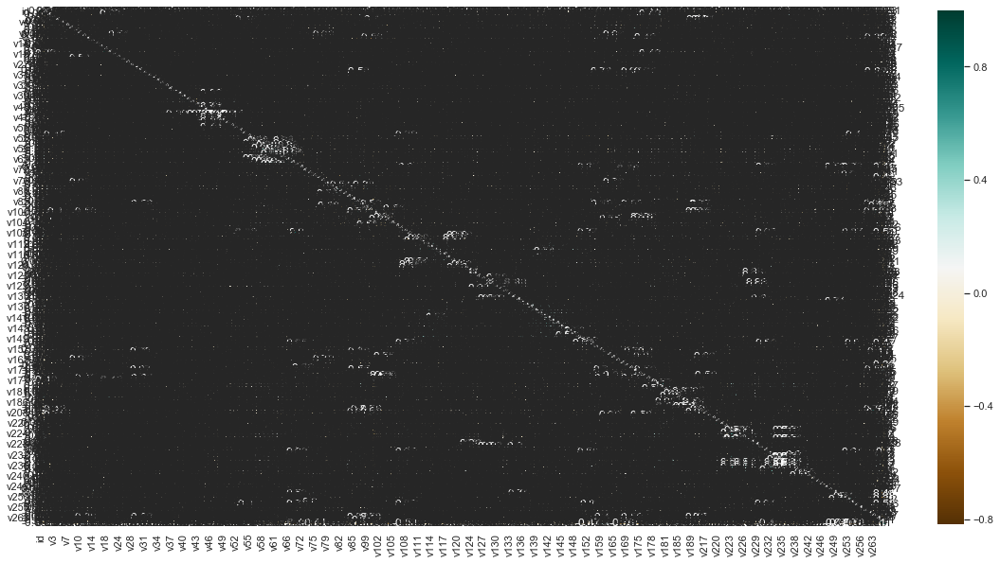

In [127]:
plt.figure(figsize=(20,10))
c= train_v5.corr()
sns.heatmap(c,cmap="BrBG",annot=True)
c

train_v















